In [1]:
import os
import cv2
import torch
import pandas as pd
import numpy as np

from torch import nn

from tqdm.notebook import tqdm
from collections import defaultdict
from torch.utils.data import Dataset, DataLoader
from transformers import get_scheduler
from transformers import SegformerForSemanticSegmentation
from torchvision import transforms as tf

import matplotlib.pyplot as plt
%matplotlib inline

2023-06-01 22:23:47.496579: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-01 22:23:49.671779: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
from loss import dice_coef_loss, tversky_index_loss, TverskyIndexLoss
from ImageDataset import ImageDataset, get_img_for_train_and_val, collate_fn
from imgPrepare import img_prepare, create_img_transform, get_img_mask
from smallModel import SmallSegFormer
from wideSegFormer import WideSegFormer, SegformerDecodeHead
from finalModel import FinalModel2
from learning_loop import learning_loop, show_examples
from train_model import create_model_and_optimizer, load_model_and_create_optimizer
%load_ext autoreload
%autoreload 2

In [3]:
model = FinalModel2()

In [4]:
train, test = get_img_for_train_and_val("data")

In [8]:
class TestDataset(Dataset):
    def __init__(self, img_names):
        super(TestDataset, self).__init__()
        self.data = img_names
        self.annotate = False
        self.resize = tf.Resize((512, 512))

    def __getitem__(self, index):
        img = cv2.imread(os.path.join("data", 'X', self.data[index]))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_mask = get_img_mask(self.data[index])
        
        input_ = self.resize(torch.from_numpy(img).short().permute((2, 0, 1)))
        img_mask = self.resize(img_mask[None])[0]
        return input_, img_mask

    def __len__(self):
        return len(self.data)

In [9]:
dataset_test = TestDataset(test)

In [10]:
m = []
for i in tqdm(range(len(dataset_test))):
    img, mask = dataset_test[i]
    res = model(img)
    m.append(dice_coef_loss(res.long(), mask, reverse=True, increase=False, axis=(0, 1)))

  0%|          | 0/129 [00:00<?, ?it/s]

In [11]:
np.array(m).mean()

0.9835158

In [27]:
np.array(m).mean()

0.985008

  0%|          | 0/129 [00:00<?, ?it/s]

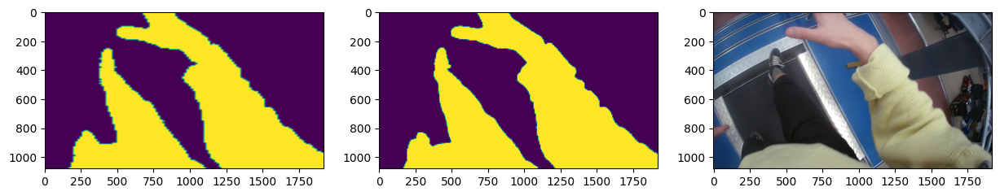

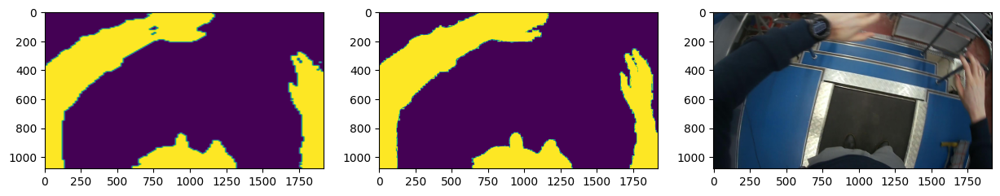

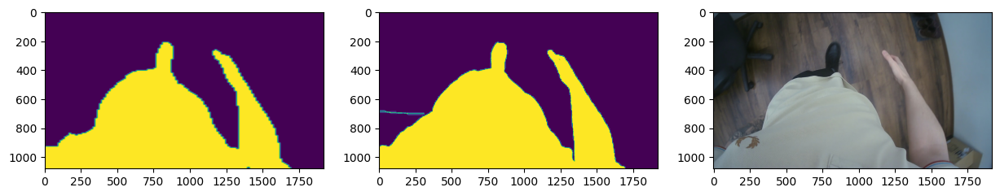

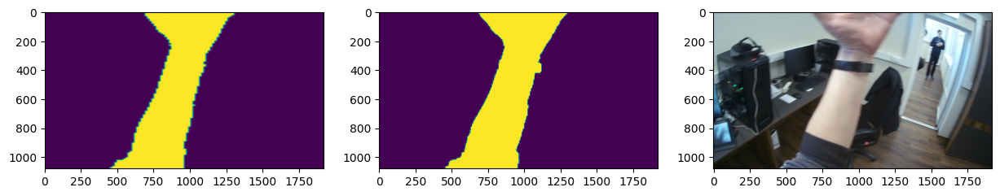

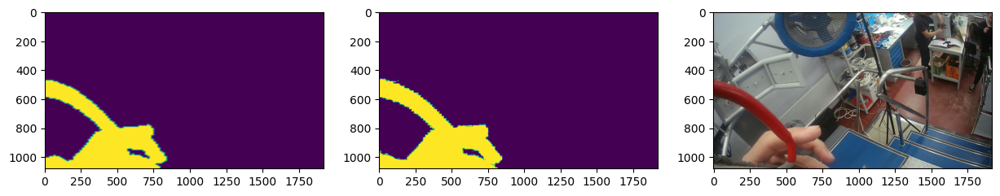

...

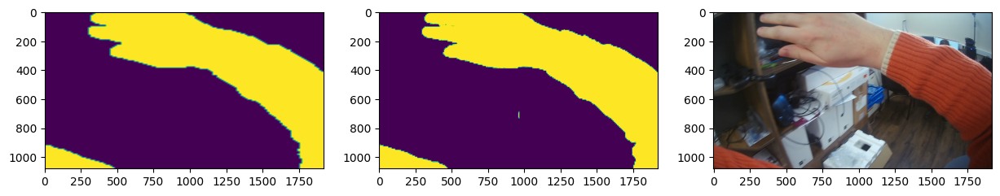

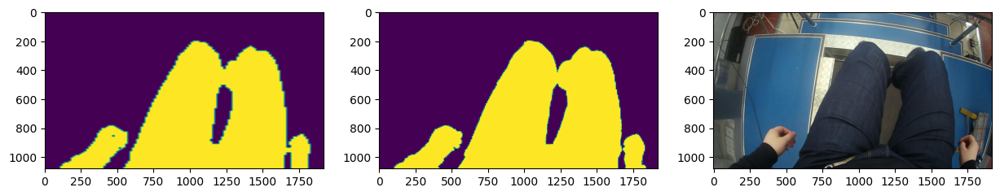

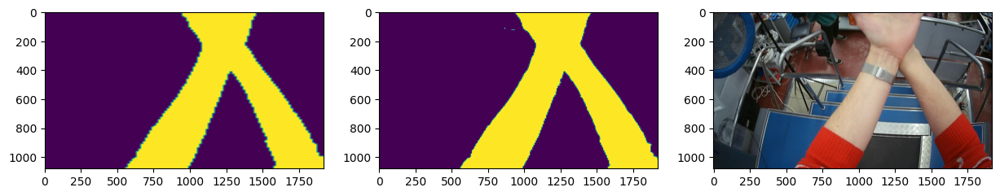

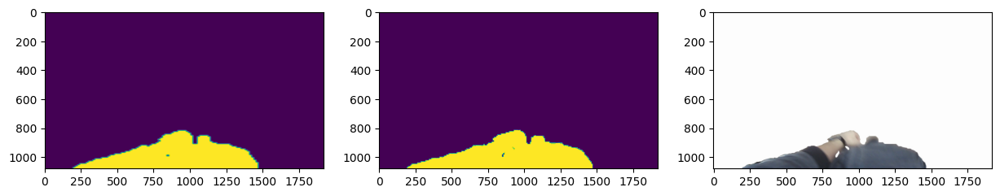

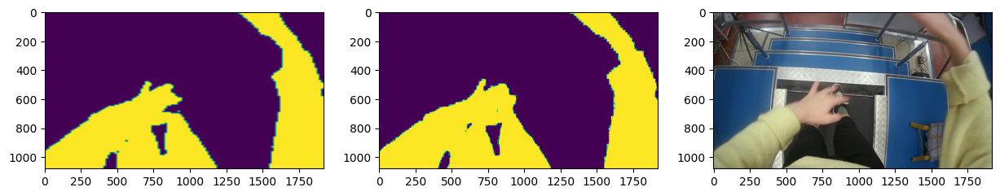

In [29]:
for i in tqdm(range(len(dataset_test))):
    img, mask = dataset_test[i]
    res = model(img)
    fig, axs = plt.subplots(nrows= 1 , ncols= 3, figsize=(15, 15))
    axs[0].imshow(res)
    axs[1].imshow(mask)
    axs[2].imshow(img.permute((1, 2, 0)).numpy())
    plt.show()